# Upload file from computer

In [2]:
from google.colab import files

# Upload the file to Colab
uploaded = files.upload()

# Read the contents of the file
filename = next(iter(uploaded))
with open(filename, 'r') as f:
  contents = f.read()


Saving poker-hand-data.csv to poker-hand-data.csv


In [4]:
import os

# Check if file exists in current directory
filename = "poker-hand-data.csv"
if os.path.exists(filename):
    print(f"File '{filename}' exists!")
else:
    print(f"File '{filename}' does not exist.")

File 'poker-hand-data.csv' exists!


# Preparing 4 subsets

In [5]:
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.tree import DecisionTreeClassifier
import graphviz
from sklearn.model_selection import train_test_split
from sklearn.tree import export_graphviz
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import seaborn as sns
df = pd.read_csv('poker-hand-data.csv')
feature_names = ["S1", "C1", "S2", "C2", "S3", "C3", "S4", "C4", "S5", "C5"]
class_names = ["Nothing", "One Pair", "Two Pairs", "Three Of A Kind", "Straight", "Flush", "Full House",
               "Four Of A Kind", "Straight Flush", "Royal Flush"]
labelencoder = LabelEncoder()
for column in df.columns:
    df[column] = labelencoder.fit_transform(df[column])
percent_train = [0.4, 0.6, 0.8, 0.9]
subsets = []
for i in range(len(percent_train)):
    X = df.drop(['Class'], axis=1)
    Y = df['Class']
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size=percent_train[i], stratify=Y, shuffle=True,
                                                        random_state=0)
    subsets.append([X_train, X_test, Y_train, Y_test])

# Distribution of original test

[Text(0, 0, '513702'),
 Text(0, 0, '433097'),
 Text(0, 0, '48828'),
 Text(0, 0, '21634'),
 Text(0, 0, '3978'),
 Text(0, 0, '2050'),
 Text(0, 0, '1460'),
 Text(0, 0, '236'),
 Text(0, 0, '17'),
 Text(0, 0, '8')]

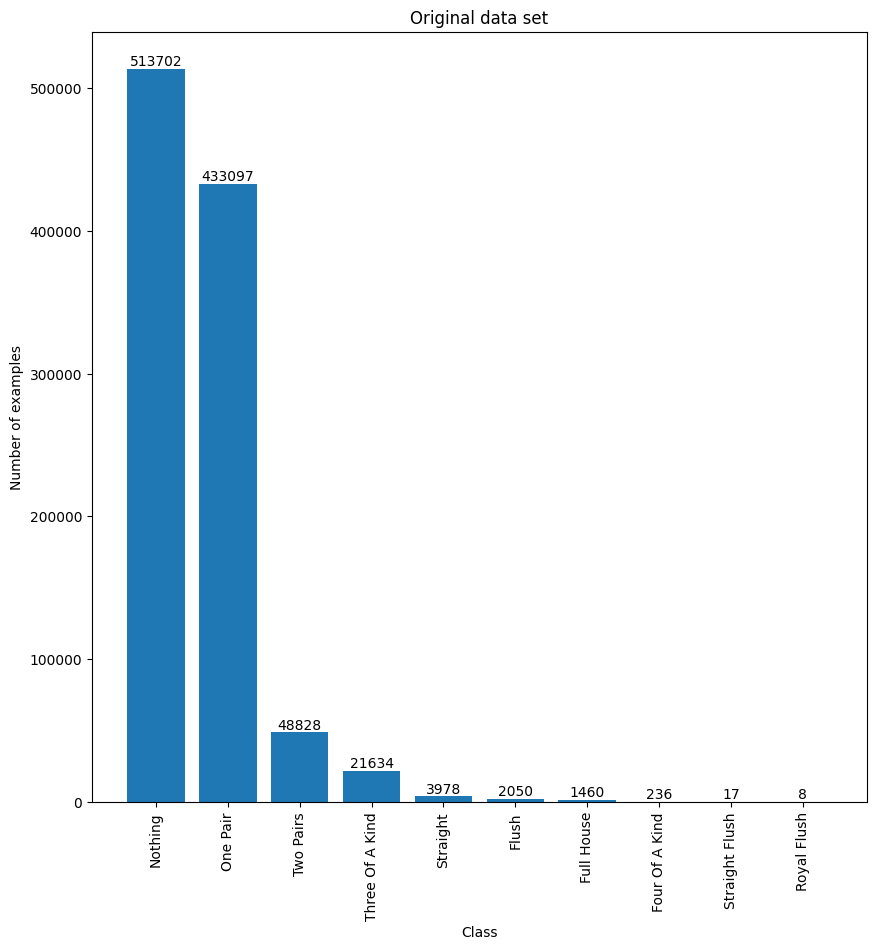

In [6]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
class_counts = df['Class'].value_counts()
axs.bar(class_counts.index, class_counts.values)
axs.set_xlabel('Class')
axs.set_ylabel('Number of examples')
axs.set_title('Original data set')

axs.set_xticks(range(len(class_names)))
axs.set_xticklabels(class_names, rotation='vertical')
axs.bar_label(axs.containers[0])

# Distribution of 4 subsets

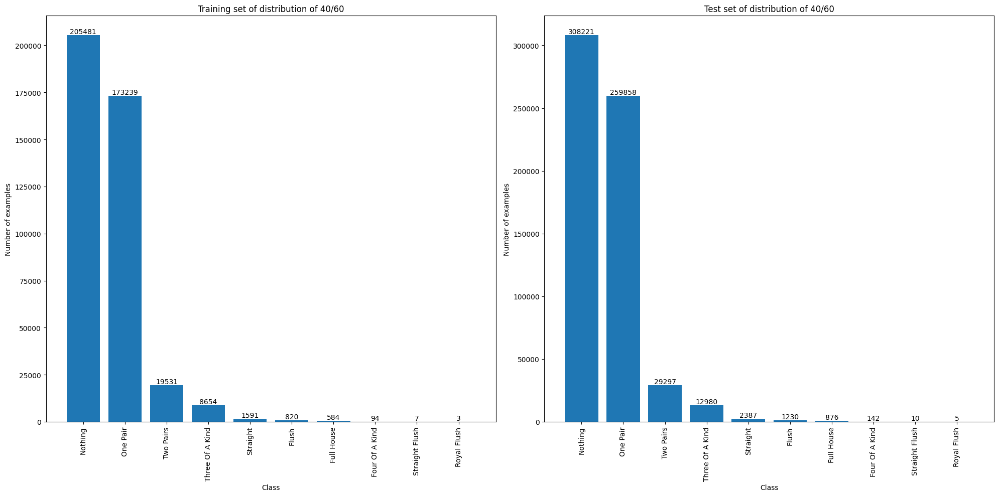

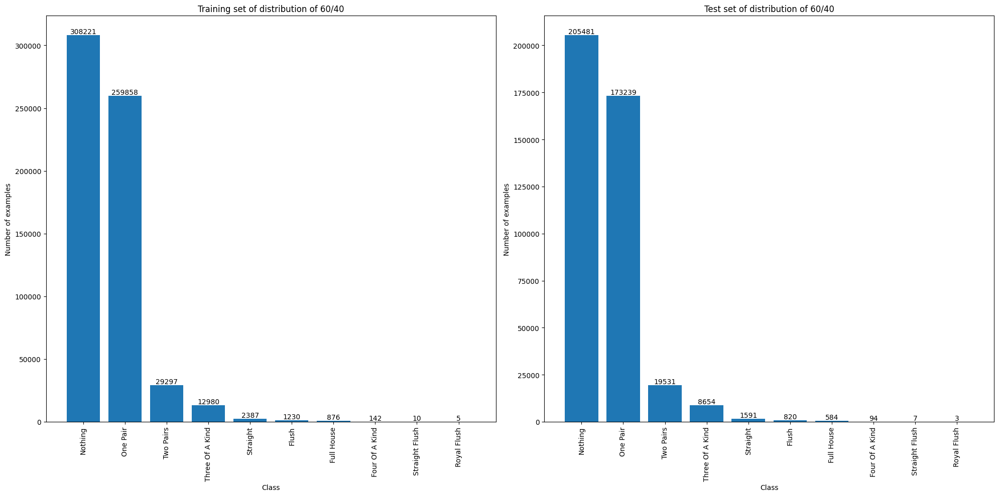

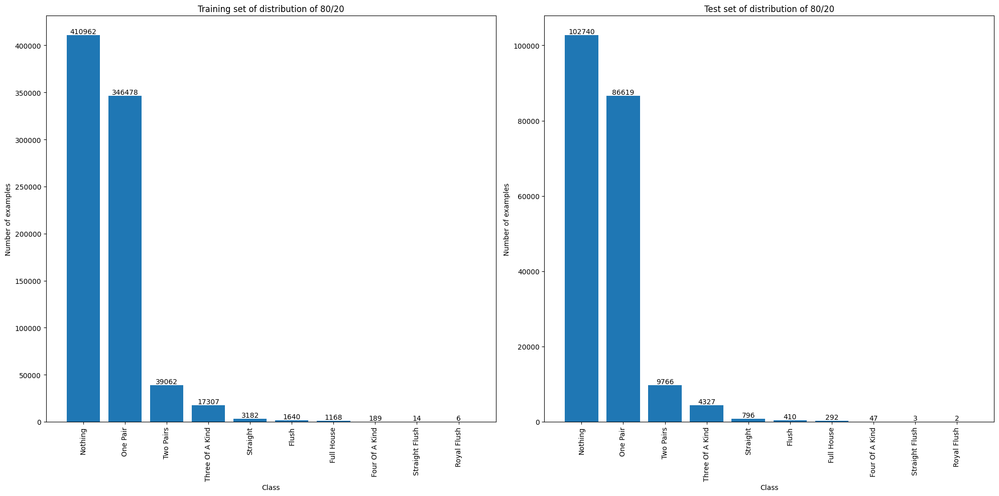

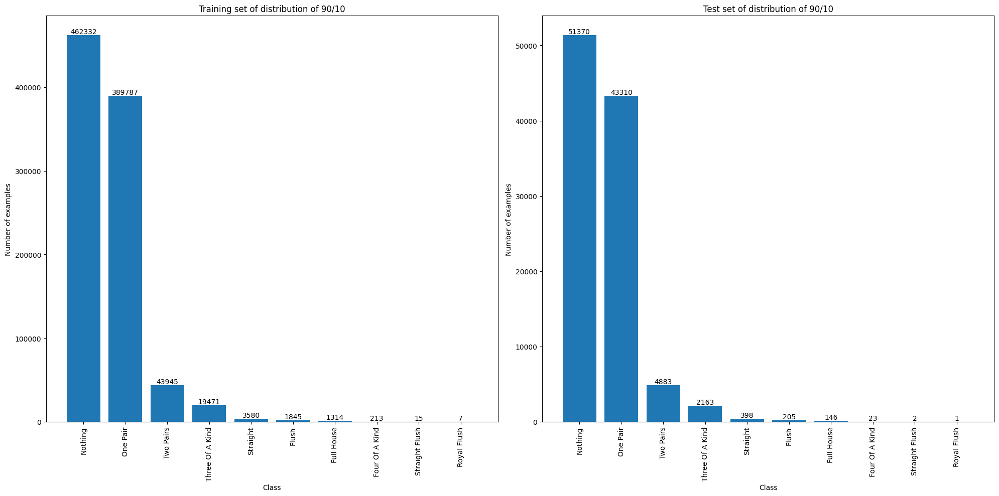

In [7]:
title = ['distribution of 40/60','distribution of 60/40','distribution of 80/20','distribution of 90/10']
def draw_distribution():
    percent_train = [0.4, 0.6, 0.8, 0.9]

    for i in range(len(subsets)):

        X_train, X_test, Y_train, Y_test =subsets[i]
        fig, axs = plt.subplots(1, 2, figsize=(20, 10))
        class_counts = Y_train.value_counts()
        axs[0].bar(class_counts.index, class_counts.values)
        axs[0].set_xlabel('Class')
        axs[0].set_ylabel('Number of examples')
        train_title = 'Training set of '+title[i]
        axs[0].set_title(train_title)
        axs[0].set_xticks(range(len(class_names)))
        axs[0].set_xticklabels(class_names, rotation='vertical')
        axs[0].bar_label(axs[0].containers[0])

        class_counts = Y_test.value_counts()
        axs[1].bar(class_counts.index, class_counts.values)
        axs[1].set_xlabel('Class')
        axs[1].set_ylabel('Number of examples')
        test_title = 'Test set of '+title[i]
        axs[1].set_title(test_title)
        axs[1].set_xticks(range(len(class_names)))
        axs[1].set_xticklabels(class_names, rotation='vertical')
        axs[1].bar_label(axs[1].containers[0])

        plt.tight_layout()
        plt.show()
        print("\n\n\n\n\n\n\n")

draw_distribution()

# For 40/60 test

Builiding the decision tree classifiers

In [20]:
decision_tree = [None] * 4
X_train,X_test,Y_train,Y_test = subsets[0]
decision_tree[0] = DecisionTreeClassifier(criterion="entropy",random_state=0)
decision_tree[0] = decision_tree[0].fit(X_train, Y_train)
dot_data = export_graphviz(decision_tree[0], out_file=None,max_depth=10,
                               feature_names=feature_names, class_names=class_names,
                               filled=True, rounded=True,
                               special_characters=True)
graph = graphviz.Source(dot_data)
graph

Evaluating the decision tree classifiers

Decision Tree Classifier report 
                  precision    recall  f1-score   support

        Nothing       0.70      0.69      0.70    308221
       One Pair       0.57      0.57      0.57    259858
      Two Pairs       0.26      0.28      0.27     29297
Three Of A Kind       0.27      0.31      0.29     12980
       Straight       0.23      0.26      0.24      2387
          Flush       0.04      0.07      0.05      1230
     Full House       0.09      0.10      0.09       876
 Four Of A Kind       0.11      0.12      0.11       142
 Straight Flush       0.00      0.00      0.00        10
    Royal Flush       0.00      0.00      0.00         5

       accuracy                           0.61    615006
      macro avg       0.23      0.24      0.23    615006
   weighted avg       0.61      0.61      0.61    615006



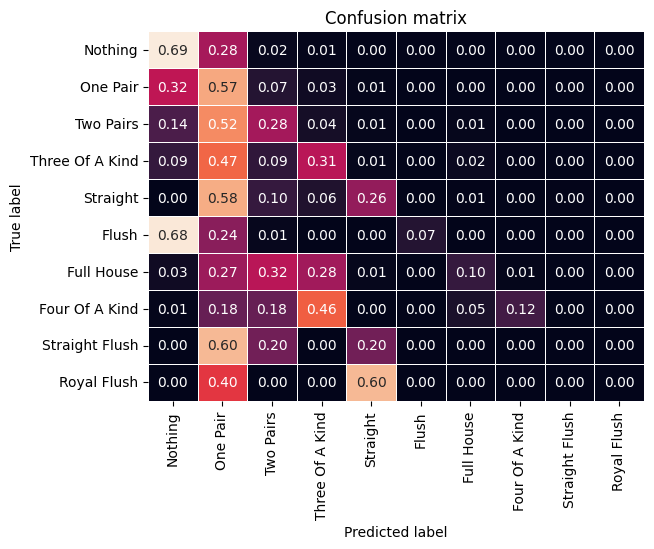

In [21]:
X_test_1 = subsets[0][1]
Y_test_1 = subsets[0][3]
y_pred_1 = decision_tree[0].predict(X_test_1)
# predict on test set

# print classification report
print("Decision Tree Classifier report \n", classification_report(Y_test_1, y_pred_1,target_names=class_names,zero_division=0))

# print confusion matrix
cfm = (confusion_matrix(Y_test_1, y_pred_1,normalize='true'))

sns.heatmap(cfm, annot=True, linewidths=.5, cbar=None,xticklabels=class_names,yticklabels=class_names,fmt='.2f')
plt.xlabel('Predicted label')
plt.ylabel('True label')
plt.title('Confusion matrix')
plt.show()

# For 60/40 test

Building the decision tree classifiers

In [22]:
X_train,X_test,Y_train,Y_test = subsets[1]
decision_tree[1] = DecisionTreeClassifier(criterion="entropy",random_state=0)
decision_tree[1] = decision_tree[1].fit(X_train, Y_train)
dot_data = export_graphviz(decision_tree[1], out_file=None,max_depth=10,
                               feature_names=feature_names, class_names=class_names,
                               filled=True, rounded=True,
                               special_characters=True)
graph = graphviz.Source(dot_data)
graph

Evaluating the decision tree classifiers

Decision Tree Classifier report 
                  precision    recall  f1-score   support

        Nothing       0.72      0.71      0.71    205481
       One Pair       0.59      0.59      0.59    173239
      Two Pairs       0.27      0.30      0.29     19531
Three Of A Kind       0.30      0.33      0.31      8654
       Straight       0.26      0.28      0.27      1591
          Flush       0.07      0.11      0.09       820
     Full House       0.11      0.13      0.12       584
 Four Of A Kind       0.09      0.13      0.11        94
 Straight Flush       0.00      0.00      0.00         7
    Royal Flush       0.00      0.00      0.00         3

       accuracy                           0.62    410004
      macro avg       0.24      0.26      0.25    410004
   weighted avg       0.63      0.62      0.63    410004



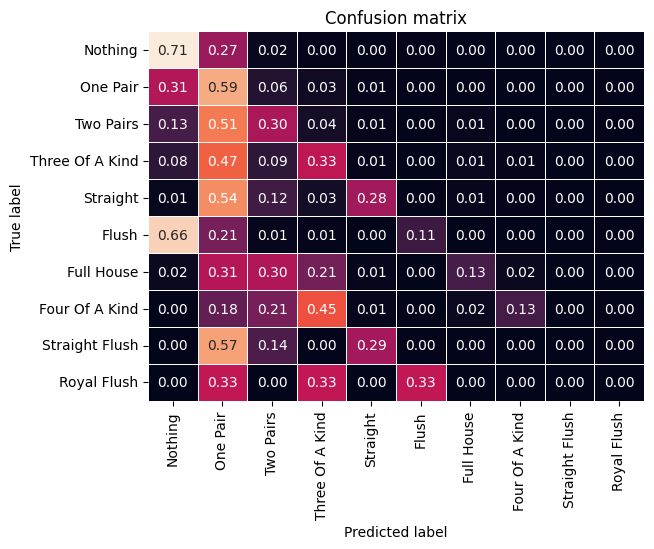

In [23]:
X_test_2 = subsets[1][1]
Y_test_2 = subsets[1][3]
y_pred_2 = decision_tree[1].predict(X_test_2)
# predict on test set

# print classification report
print("Decision Tree Classifier report \n", classification_report(Y_test_2, y_pred_2,target_names=class_names,zero_division=0))

# print confusion matrix
cfm = (confusion_matrix(Y_test_2, y_pred_2,normalize='true'))

sns.heatmap(cfm, annot=True, linewidths=.5, cbar=None,xticklabels=class_names,yticklabels=class_names,fmt='.2f')
plt.xlabel('Predicted label')
plt.ylabel('True label')
plt.title('Confusion matrix')
plt.show()

# For 80/20 test

Building the decision tree classifiers

In [28]:
X_train,X_test,Y_train,Y_test = subsets[2]
decision_tree[2] = DecisionTreeClassifier(criterion="entropy",random_state=0)
decision_tree[2] = decision_tree[2].fit(X_train, Y_train)
dot_data = export_graphviz(decision_tree[2], out_file=None,max_depth=10,
                               feature_names=feature_names, class_names=class_names,
                               filled=True, rounded=True,
                               special_characters=True)
graph = graphviz.Source(dot_data)
graph

Evaluating the decision tree classifiers

Decision Tree Classifier report 
                  precision    recall  f1-score   support

        Nothing       0.73      0.72      0.72    102740
       One Pair       0.61      0.60      0.61     86619
      Two Pairs       0.30      0.32      0.31      9766
Three Of A Kind       0.33      0.37      0.35      4327
       Straight       0.27      0.29      0.28       796
          Flush       0.07      0.10      0.08       410
     Full House       0.15      0.17      0.16       292
 Four Of A Kind       0.08      0.09      0.08        47
 Straight Flush       0.00      0.00      0.00         3
    Royal Flush       0.00      0.00      0.00         2

       accuracy                           0.64    205002
      macro avg       0.25      0.27      0.26    205002
   weighted avg       0.64      0.64      0.64    205002



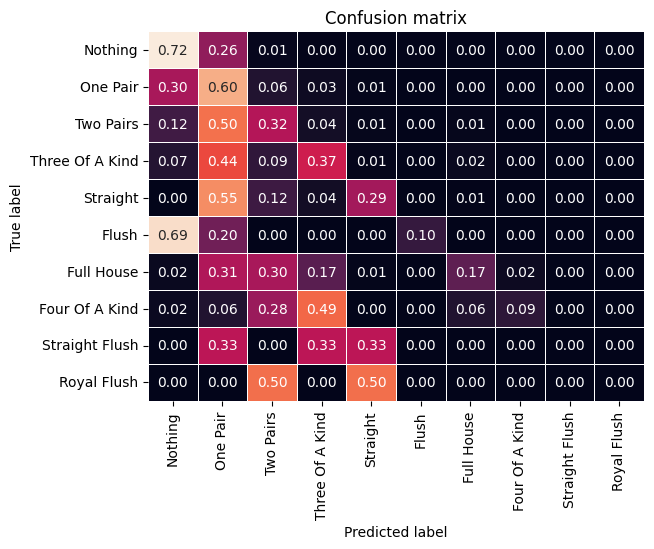

In [29]:
X_test_3 = subsets[2][1]
Y_test_3 = subsets[2][3]
y_pred_3 = decision_tree[2].predict(X_test_3)
# predict on test set

# print classification report
print("Decision Tree Classifier report \n", classification_report(Y_test_3, y_pred_3,target_names=class_names,zero_division=0))

# print confusion matrix
cfm = (confusion_matrix(Y_test_3, y_pred_3,normalize='true'))

sns.heatmap(cfm, annot=True, linewidths=.5, cbar=None,xticklabels=class_names,yticklabels=class_names,fmt='.2f')
plt.xlabel('Predicted label')
plt.ylabel('True label')
plt.title('Confusion matrix')
plt.show()

# For 90/10 test

Building the decision tree classifiers

In [30]:
X_train,X_test,Y_train,Y_test = subsets[3]
decision_tree[3] = DecisionTreeClassifier(criterion="entropy",random_state=0)
decision_tree[3] = decision_tree[3].fit(X_train, Y_train)
dot_data = export_graphviz(decision_tree[3], out_file=None,max_depth=10,
                               feature_names=feature_names, class_names=class_names,
                               filled=True, rounded=True,
                               special_characters=True)
graph = graphviz.Source(dot_data)
graph

Evaluating the decision tree classifiers

Decision Tree Classifier report 
                  precision    recall  f1-score   support

        Nothing       0.74      0.73      0.73     51370
       One Pair       0.62      0.62      0.62     43310
      Two Pairs       0.31      0.33      0.32      4883
Three Of A Kind       0.35      0.39      0.37      2163
       Straight       0.29      0.29      0.29       398
          Flush       0.08      0.13      0.10       205
     Full House       0.19      0.21      0.20       146
 Four Of A Kind       0.07      0.09      0.08        23
 Straight Flush       0.00      0.00      0.00         2
    Royal Flush       0.00      0.00      0.00         1

       accuracy                           0.65    102501
      macro avg       0.26      0.28      0.27    102501
   weighted avg       0.65      0.65      0.65    102501



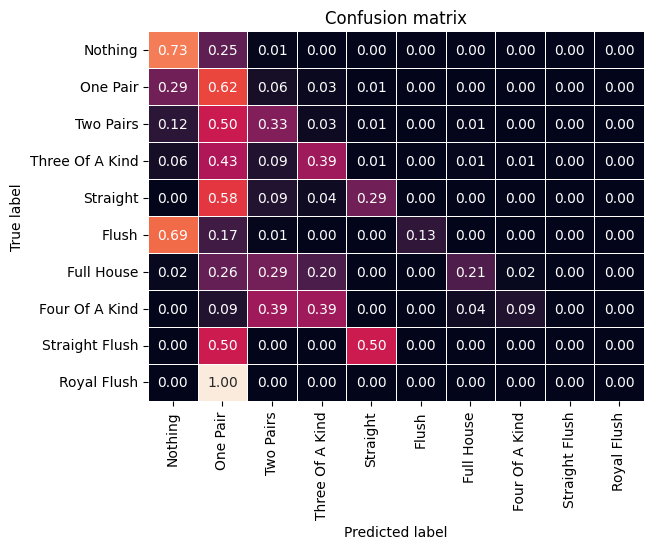

In [31]:
X_test_4 = subsets[3][1]
Y_test_4 = subsets[3][3]
y_pred_4 = decision_tree[3].predict(X_test_4)
# predict on test set

# print classification report
print("Decision Tree Classifier report \n", classification_report(Y_test_4, y_pred_4,target_names=class_names,zero_division=0))

# print confusion matrix
cfm = (confusion_matrix(Y_test_4, y_pred_4,normalize='true'))

sns.heatmap(cfm, annot=True, linewidths=.5, cbar=None,xticklabels=class_names,yticklabels=class_names,fmt='.2f')
plt.xlabel('Predicted label')
plt.ylabel('True label')
plt.title('Confusion matrix')
plt.show()

# The depth and accuracy of a decision tree

In [32]:
feature_train,feature_test,label_train,label_test = subsets[2]

# Max depth = None

In [33]:
tree_None = DecisionTreeClassifier(criterion="entropy",random_state=0)
tree_None = tree_None.fit(feature_train, label_train)
dot_data = export_graphviz(tree_None, out_file=None,max_depth=10,
                               feature_names=feature_names, class_names=class_names,
                               filled=True, rounded=True,
                               special_characters=True)
graph = graphviz.Source(dot_data)
graph

Accuracy score

In [34]:
y_pred_None = tree_None.predict(feature_test)
print(accuracy_score(label_test, y_pred_None))

0.6399059521370524


# Max depth = 2

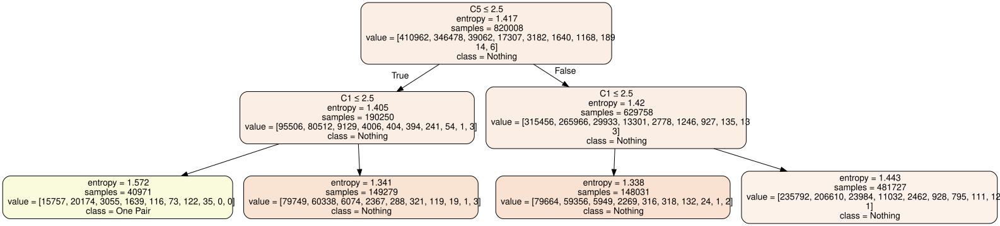

In [42]:
tree_2 = DecisionTreeClassifier(criterion="entropy",random_state=0,max_depth =2)
tree_2 = tree_2.fit(feature_train, label_train)
dot_data = export_graphviz(tree_2, out_file=None,max_depth=2,
                               feature_names=feature_names, class_names=class_names,
                               filled=True, rounded=True,
                               special_characters=True)
graph = graphviz.Source(dot_data)
graph

Accuracy score

In [43]:
y_pred_2 = tree_2.predict(feature_test)
print(accuracy_score(label_test, y_pred_2))

0.5062292075199266


# Max depth = 3

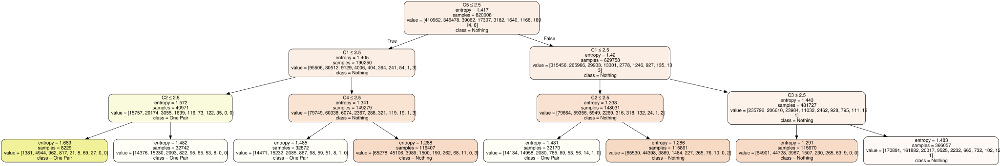

In [40]:
tree_3 = DecisionTreeClassifier(criterion="entropy",random_state=0,max_depth = 3)
tree_3 = tree_3.fit(feature_train, label_train)
dot_data = export_graphviz(tree_3, out_file=None,max_depth=3,
                               feature_names=feature_names, class_names=class_names,
                               filled=True, rounded=True,
                               special_characters=True)
graph = graphviz.Source(dot_data)
graph

Accuracy score

In [41]:
y_pred_3 = tree_3.predict(feature_test)
print(accuracy_score(label_test, y_pred_3))

0.5082877240222047


# Max depth = 4

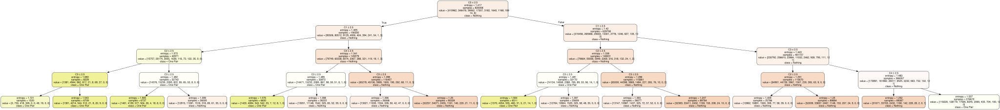

In [44]:
tree_4 = DecisionTreeClassifier(criterion="entropy",random_state=0,max_depth = 4)
tree_4 = tree_4.fit(feature_train, label_train)
dot_data = export_graphviz(tree_4, out_file=None,max_depth=4,
                               feature_names=feature_names, class_names=class_names,
                               filled=True, rounded=True,
                               special_characters=True)
graph = graphviz.Source(dot_data)
graph

Accuracy score

In [45]:
y_pred_4 = tree_4.predict(feature_test)
print(accuracy_score(label_test, y_pred_4))

0.5246680520190047


# Max depth = 5

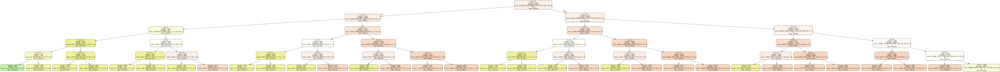

In [46]:
tree_5 = DecisionTreeClassifier(criterion="entropy",random_state=0,max_depth=5)
tree_5 = tree_5.fit(feature_train, label_train)
dot_data = export_graphviz(tree_5, out_file=None,max_depth=5,
                               feature_names=feature_names, class_names=class_names,
                               filled=True, rounded=True,
                               special_characters=True)
graph = graphviz.Source(dot_data)
graph


Accuracy score

In [47]:
y_pred_5 = tree_5.predict(feature_test)
print(accuracy_score(label_test, y_pred_5))

0.5566335938185969


# Max depth = 6

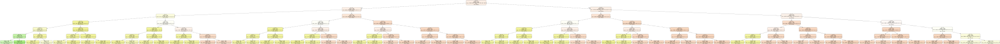

In [48]:
tree_6 = DecisionTreeClassifier(criterion="entropy",random_state=0,max_depth = 6)
tree_6 = tree_6.fit(feature_train, label_train)
dot_data = export_graphviz(tree_6, out_file=None,max_depth=6,
                               feature_names=feature_names, class_names=class_names,
                               filled=True, rounded=True,
                               special_characters=True)
graph = graphviz.Source(dot_data)
graph


Accuracy score

In [49]:
y_pred_6 = tree_6.predict(feature_test)
print(accuracy_score(label_test, y_pred_6))

0.5566335938185969


# Max depth = 7

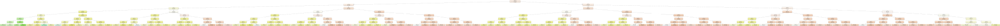

In [50]:
tree_7 = DecisionTreeClassifier(criterion="entropy",random_state=0,max_depth=7)
tree_7 = tree_7.fit(feature_train, label_train)
dot_data = export_graphviz(tree_7, out_file=None,max_depth=7,
                               feature_names=feature_names, class_names=class_names,
                               filled=True, rounded=True,
                               special_characters=True)
graph = graphviz.Source(dot_data)
graph


Accuracy score

In [51]:
y_pred_7 = tree_7.predict(feature_test)
print(accuracy_score(label_test, y_pred_7))

0.5568823718792988
